In [ ]:
################## Define filepaths #####################
data_fp = "drive/My Drive/data"
model_fp = "drive/My Drive/model"

In [ ]:
# Colab essentials
try:
  from google.colab import drive
  drive.mount('/content/drive', force_remount=True)
  !pip install bertopic[visualization]
  !pip install -U gensim
  !pip install pytextrank
except:
  pass

Mounted at /content/drive
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 120.7/120.7 KB 4.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.0/86.0 KB 10.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 KB 7.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.2/5.2 MB 54.6 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.8/6.8 MB 63.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 65.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.8/199.8 KB 20.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 66.3 MB/s eta 0:00:00
  Preparing metadat

In [ ]:
import pandas as pd
import numpy as np
from ast import literal_eval
from urllib.parse import urlparse
import itertools
import re
from collections import Counter
import string

#Plot
import seaborn as sns
from matplotlib import pyplot as plt
from wordcloud import WordCloud

# NLTK and spacy
import spacy
import nltk
from nltk.sentiment import SentimentIntensityAnalyzer
from nltk.stem import WordNetLemmatizer, PorterStemmer
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize, sent_tokenize

# Ranking Models
import pytextrank

# Gensim
import gensim.corpora as corpora
from gensim.corpora.dictionary import Dictionary
from gensim.models.coherencemodel import CoherenceModel

#Models
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import NMF
from bertopic import BERTopic
from sentence_transformers import SentenceTransformer
from umap import UMAP
from transformers import pipeline

#Coherence
from gensim.models.coherencemodel import CoherenceModel
# Warnings
import warnings
warnings.filterwarnings("ignore")

In [ ]:
spacy.cli.download("en_core_web_sm")
nlp = spacy.load('en_core_web_sm')
nltk.download('vader_lexicon')

✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')


[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


True

# Data Understanding

This seciton is to explore all the data fields within the dataset.

In [ ]:
# Read dataframe
# Ensure that data is placed in /data
df = pd.read_csv('{}/indonesia_news_jan_may_2020.csv'.format(data_fp), index_col =0 )
# Display df dimensions
print(df.shape)

# Apply correct datatype
df['Author'] = df['Author'].apply(lambda x: literal_eval(x))
df['NormalisedDate'] = pd.to_datetime(df['NormalisedDate'])

df.head(20)

(7030, 5)


,NormalisedDate,SOURCEURL,Title,Author,Text
0,2020-04-01,https://www.aninews.in/news/national/general-n...,Eight Indonesians who attended Tablighi Jamaat...,[],"Bijnor (Uttar Pradesh) [India], Apr 1 (ANI): E..."
1,2020-04-01,https://in.news.yahoo.com/17-foreign-two-india...,"17 foreign, two Indian participants of Nizamud...",[],"Bahraich, Mar 31 (PTI) As many as 17 foreign n..."
2,2020-04-01,https://www.freepressjournal.in/india/latest-c...,Latest coronavirus update: Tamil Nadu sees big...,[],Chennai: Tamil Nadu on Tuesday saw the steepes...
3,2020-04-01,https://www.business-standard.com/article/news...,Eight Indonesians who attended Tablighi Jamaat...,[],Eight Indonesians who had participated in the ...
4,2020-04-01,https://www.thejakartapost.com/academia/2020/0...,Humanity shines,[The Jakarta Post],"Though accustomed to disasters, Indonesians ar..."
5,2020-04-01,https://www.orissapost.com/enough-of-theatrics/,Enough of theatrics,[],The unplanned manner in which Prime Minister M...
6,2020-04-01,https://www.vir.com.vn/historic-deal-augurs-tr...,Historic deal augurs trade renaissance,"[Vietnam Investment Review - Vir, Thanh Dat]",The 29th meeting of the RCEP Trade Negotiation...
7,2020-04-01,https://www.msn.com/en-in/entertainment/bollyw...,Tablighi Jamaat congregation: First link was s...,[],© Provided by The Indian Express\n\nThe connec...
8,2020-04-01,https://www.ndtv.com/video/news/news/6-who-att...,6 Who Attended Delhi Mosque Congregation Die O...,[],Six people who attended a congregation at a mo...
9,2020-04-01,https://www.businessadvantagepng.com/how-can-p...,How can Papua New Guinea fight African swine f...,"[Paul Chai, Business Advantage Png, Laura Wate...",by\n\nWith the recent death of more than 300 p...


In [ ]:
# Check dataframe for missing values
print(df.isna().any())
print(df[df.Title.isna()].SOURCEURL) ## Could ignore due to low number of missing values and non-crucial field

NormalisedDate    False
SOURCEURL         False
Title              True
Author            False
Text              False
dtype: bool
4193    https://www.dw.com/overlay/media/en/indonesias...
4261    https://www.dw.com/overlay/media/en/slash-and-...
5016    https://www.dw.com/overlay/media/en/indonesia-...
6532    http://en.acnnewswire.com/press-release/englis...
Name: SOURCEURL, dtype: object


## Date/Volume

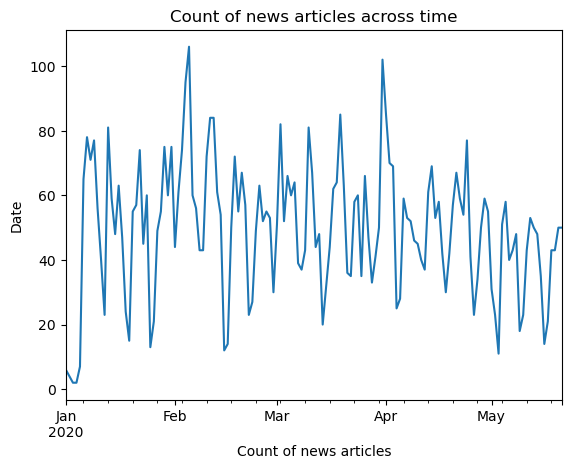

In [ ]:
# Generic Trend across date
df.groupby('NormalisedDate')['Title'].count().plot()
plt.xlabel('Count of news articles')
plt.ylabel('Date')
plt.title('Count of news articles across time')

plt.show()

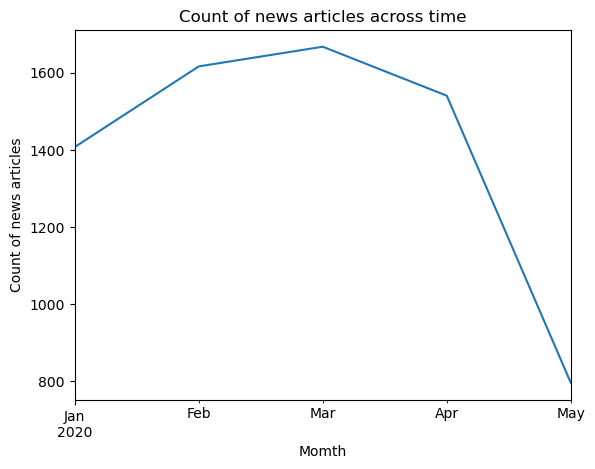

In [ ]:
# Generic Trend across months
df_copy = df.copy()
df_copy['months'] = df_copy.NormalisedDate.dt.to_period('M')
df_copy.groupby('months')['Title'].count().plot()
plt.ylabel('Count of news articles')
plt.xlabel('Month')
plt.title('Count of news articles across time')

plt.show()

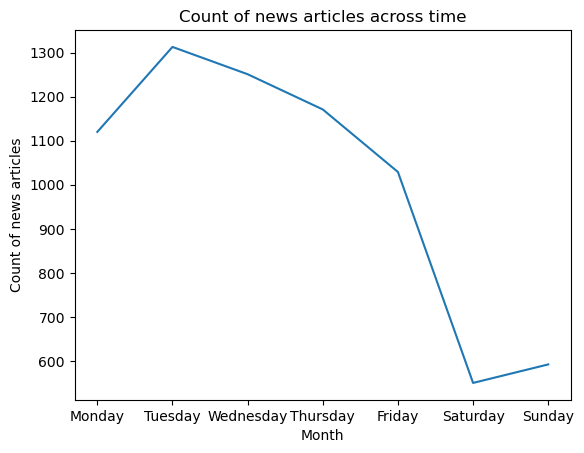

In [ ]:
# Is there any trend across weekdays?
class_list = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
df_copy['weekday'] = df_copy.NormalisedDate.dt.day_name().astype(str)

df_grouped = df_copy.groupby('weekday')['Title'].count()
df_grouped.loc[class_list].plot()
plt.ylabel('Count of news articles')
plt.xlabel('Month')
plt.title('Count of news articles across time')

plt.show()

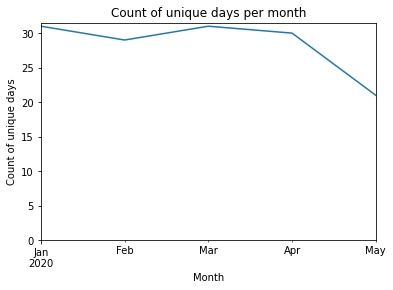

In [ ]:
# Generic Trend across months
df_copy = df.copy()
df_copy['NormalisedDate'] = pd.to_datetime(df_copy['NormalisedDate'] )

df_copy['months'] = df_copy.NormalisedDate.dt.to_period('M')
df_copy.groupby('months')['NormalisedDate'].nunique().plot()
plt.ylabel('Count of unique days')
plt.xlabel('Month')
plt.title('Count of unique days per month')
plt.ylim(0)
plt.show()

## URL

In [ ]:
# Extract source where source is defined as 
df['source'] = df['SOURCEURL'].str.split('/').str.get(2).replace(r'www[\d]?.', '', regex=True).apply(lambda x: '.'.join(x.split('.')[:-1]) if len(x.split('.'))>1 else x)
sorted(list(df['source'].unique()))

['1460kltc.iheart',
 '325.nostate',
 '35mmc',
 '365.military',
 '680news',
 '7news.com',
 '929thebull',
 '9and10news',
 '9news.com',
 'aa.com',
 'aawsat',
 'abbynews',
 'abc.net',
 'abc11',
 'abc7news',
 'abcnews.go',
 'aberdeennews',
 'abqjournal',
 'abudhabicityguide',
 'accesswdun',
 'adaderana',
 'adelaidenow.com',
 'adgully',
 'adn',
 'adonis49.wordpress',
 'adventuretravelnews',
 'advocate',
 'aerosociety',
 'aerospace-technology',
 'aerospacemanufacturinganddesign',
 'aerotechnews',
 'aerotelegraph',
 'af.reuters',
 'afghanistantimes',
 'afr',
 'africanews',
 'afrik21',
 'agassizharrisonobserver',
 'agcanada',
 'agenda',
 'agmetalminer',
 'agriculture',
 'agupdate',
 'aidspan',
 'ainonline',
 'airdrietoday',
 'airforce-technology',
 'airport-technology',
 'akipress',
 'al-monitor',
 'alaraby.co',
 'albawaba',
 'alexinwanderland',
 'aljazeera',
 'all-noise.co',
 'allafrica',
 'allhiphop',
 'allindiaroundup',
 'am970theanswer',
 'americanmilitarynews',
 'amm',
 'amusingplanet',
 '

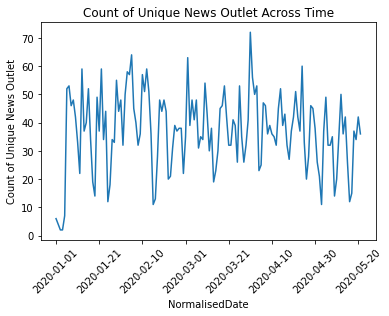

In [ ]:
# Count of unique news outlet across time
df.groupby('NormalisedDate')['source'].nunique().plot()
plt.ylabel("Count of Unique News Outlet")
plt.xticks(rotation=45)
plt.title("Count of Unique News Outlet Across Time")
plt.show()

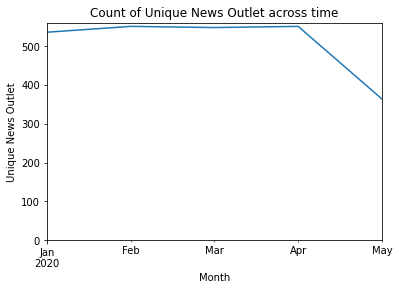

In [ ]:
# Plot Count of unique news outlet across time
df_copy = df.copy()
df_copy['NormalisedDate'] = pd.to_datetime(df_copy['NormalisedDate'] )
df_copy['months'] = df_copy.NormalisedDate.dt.to_period('M')
df_copy.groupby('months')['source'].nunique().plot()
plt.ylabel('Unique News Outlet')
plt.xlabel('Month')
plt.title('Count of Unique News Outlet across time')
plt.ylim(0)
plt.show()

## Article

In [ ]:
# Check for duplicated entries
duplicated = df[df.Title.isin(df[df.duplicated(subset=['Title'])].Title.values)].sort_values('Title')
print(duplicated.shape[0]/2)
duplicated

430.0


,NormalisedDate,SOURCEURL,Title,Author,Text,source,ner
3771,2020-03-21,https://news.yahoo.com/mess-america-why-asia-n...,'A mess in America': Why Asia now looks safer ...,[Shashank Bengali],"In January, as Singapore racked up the highest...",news.yahoo,"[Singapore, China, Shasta Grant, Indianapolis,..."
4576,2020-03-20,https://www.latimes.com/world-nation/story/202...,'A mess in America': Why Asia now looks safer ...,"[Staff Writer, Shashank Bengali Is A Southeast...","In January, as Singapore racked up the highest...",latimes,"[Singapore, China, Shasta Grant, Indianapolis,..."
5013,2020-02-03,https://www.zawya.com/mena/en/legal/story/Ban_...,'Ban on Indonesian maids to Middle East still ...,[Staff Writer],KUWAIT CITY: Ambassador of Indonesia to Kuwait...,zawya,"[Indonesia, Kuwait Tri Tharyat, the Middle Eas..."
6259,2020-02-02,http://www.arabtimesonline.com/news/ban-on-ind...,'Ban on Indonesian maids to Middle East still ...,[Arab Times],"KUWAIT CITY, Feb 2: Ambassador of Indonesia to...",arabtimesonline,"[KUWAIT CITY, Indonesia, Kuwait Tri Tharyat, t..."
506,2020-04-14,https://www.gwinnettdailypost.com/news/world_n...,'Ghosts' try to spook people off streets durin...,[Emma Reynolds],Business Newsletter Get the latest business ne...,gwinnettdailypost,"[Business Newsletter Get, Coronavirus, Gwinnet..."
...,...,...,...,...,...,...,...
1954,2020-01-08,https://www.zehabesha.com/2019/05/,ZeHabesha Latest Ethiopian News Provider,[Pandemic Tax-Remit Scheme Does Not Provide Re...,"John Alechenu, Abuja The Ministry of Foreign A...",zehabesha,"[John Alechenu, Abuja The Ministry of Foreign ..."
4193,2020-01-11,https://www.dw.com/overlay/media/en/indonesias...,NaN,[],DW News\n\nIndonesia's trans people build comm...,dw,"[DW News, Indonesia, 04:13 Share DW News, Indo..."
4261,2020-04-30,https://www.dw.com/overlay/media/en/slash-and-...,NaN,[],DW News\n\nSlash and burn - When farmers destr...,dw,"[DW News, Slash, Send Facebook, Whatsapp Tumbl..."
5016,2020-02-03,https://www.dw.com/overlay/media/en/indonesia-...,NaN,[],DW News\n\nIndonesia rocked by protests agains...,dw,"[DW News, Indonesia, 01:17 Share DW News Indon..."


In [ ]:
# What is the average length of the article body?
df.Text.str.len().describe()

count     7030.000000
mean      3525.686486
std       4103.889631
min         43.000000
25%       1550.000000
50%       2514.000000
75%       4190.000000
max      53901.000000
Name: Text, dtype: float64

### NER

To extract key entities so that we can get a better understanding of the text.

In [ ]:
# Extract NER
to_filter = ['PERCENT', 'CARDINAL', 'MONEY', 'DATE',  'QUANTITY', 'ORDINAL', 'TIME'] # Filter out numerical entities as they usually have low interpretability
df['ner'] = df['Text'].apply(lambda x: [ str(entity) for entity in nlp(x).ents if str(entity.label_) not in to_filter])
df['ner_labels'] = df['Text'].apply(lambda x: [ str(entity.label_) for entity in nlp(x).ents if str(entity.label_) not in to_filter]) # Save labels as well
df.to_csv('{}/df_cleaned.csv'.format(data_fp))
df.head()

,NormalisedDate,SOURCEURL,Title,Author,Text,ner,ner_labels
0,2020-04-01,https://www.aninews.in/news/national/general-n...,Eight Indonesians who attended Tablighi Jamaat...,[],"Bijnor (Uttar Pradesh) [India], Apr 1 (ANI): E...","[India, ANI, Indonesians, Nizamuddin, Nagina, ...","[GPE, ORG, NORP, PERSON, LOC, PERSON, NORP, GP..."
1,2020-04-01,https://in.news.yahoo.com/17-foreign-two-india...,"17 foreign, two Indian participants of Nizamud...",[],"Bahraich, Mar 31 (PTI) As many as 17 foreign n...","[Bahraich, PTI, Indonesia, Thailand, Indian Mu...","[GPE, ORG, GPE, GPE, NORP, NORP, PERSON, GPE, ..."
2,2020-04-01,https://www.freepressjournal.in/india/latest-c...,Latest coronavirus update: Tamil Nadu sees big...,[],Chennai: Tamil Nadu on Tuesday saw the steepes...,"[Tamil Nadu, Health, Beela Rajesh, Delhi Nizam...","[PERSON, ORG, PERSON, PERSON, PERSON, GPE, PER..."
3,2020-04-01,https://www.business-standard.com/article/news...,Eight Indonesians who attended Tablighi Jamaat...,[],Eight Indonesians who had participated in the ...,"[Indonesians, Nizamuddin, Nagina, Sanjay Singh...","[NORP, PERSON, LOC, PERSON, NORP, GPE, GPE, PE..."
4,2020-04-01,https://www.thejakartapost.com/academia/2020/0...,Humanity shines,[The Jakarta Post],"Though accustomed to disasters, Indonesians ar...","[Indonesians, COVID-19, the Health Quarantine ...","[NORP, ORG, LAW, GPE, NORP, ORG, GPE, ORG, PER..."


In [ ]:
def count_keyword_frequency(keyword_column):
    """Get frequency of each keyword within dataset"""
    count_values = dict(Counter(list(itertools.chain(*list(keyword_column)))))
    dict_count = dict(sorted(count_values.items(), key=lambda item: item[1], reverse=True))
    print("Frequency of keywords: ", take(20, dict_count.items()))
    count_articles = pd.DataFrame(dict_count.items()).rename({0:'keyword', 1:'Number of articles'},axis=1).groupby('Number of articles')['keyword'].count().reset_index().rename({'keyword':'No. of keywords'},axis=1).sort_values('Number of articles', ascending = False)
    count_articles['cusum No. of keywords'] = count_articles['No. of keywords'].cumsum()
    print(pd.DataFrame(list(dict_count.values())).describe().round(0))
    return dict_count

def print_unique_values(keyword_column):
    """Print unique values of all keywords"""
    all_unique_values = list(set(list(itertools.chain(*list(keyword_column)))))
    #print("Unique Keyword list: ", all_unique_values)
    print("Unique Keyword length: ",len(all_unique_values))
    print("Percentage Missing: ", len(keyword_column[keyword_column.str.len()==0])/len(keyword_column))


def take(n, iterable):
    """Return the first n items of the iterable as a list."""
    return list(itertools.islice(iterable, n))

In [ ]:
keyword_column = df['ner']
keyword_count = count_keyword_frequency(keyword_column) ## Print top keywords and the data description of its occurence
print(keyword_count) 
print_unique_values(keyword_column)

Frequency of keywords:  [('Indonesia', 18064), ('China', 11739), ('Indonesian', 7275), ('COVID-19', 6520), ('Chinese', 5034), ('Jakarta', 4327), ('Wuhan', 3626), ('Singapore', 3314), ('Malaysia', 3269), ('India', 3022), ('US', 2446), ('Australia', 2360), ('Indonesians', 1638), ('Vietnam', 1623), ('Japan', 1598), ('Thailand', 1563), ('Philippines', 1495), ('U.S.', 1486), ('Beijing', 1452), ('Hong Kong', 1418)]
             0
count  56143.0
mean       6.0
std      113.0
min        1.0
25%        1.0
50%        1.0
75%        2.0
max    18064.0
{'Indonesia': 18064, 'China': 11739, 'Indonesian': 7275, 'COVID-19': 6520, 'Chinese': 5034, 'Jakarta': 4327, 'Wuhan': 3626, 'Singapore': 3314, 'Malaysia': 3269, 'India': 3022, 'US': 2446, 'Australia': 2360, 'Indonesians': 1638, 'Vietnam': 1623, 'Japan': 1598, 'Thailand': 1563, 'Philippines': 1495, 'U.S.': 1486, 'Beijing': 1452, 'Hong Kong': 1418, 'Reuters': 1415, 'Bali': 1333, 'South Korea': 1217, 'Iran': 1078, 'Muslim': 1068, 'the United States': 

### Keywords


In [ ]:
# Read file 
df = pd.read_csv('{}/df_cleaned.csv'.format(data_fp), index_col =0)
# Clean date
df['NormalisedDate'] = pd.to_datetime(df['NormalisedDate'])
df.head()

,NormalisedDate,SOURCEURL,Title,Author,Text,ner,ner_labels,Text_cleaned,keywords_textrank,sentiment,neg,neu,pos,compound,sentiment_score
0,2020-04-01,https://www.aninews.in/news/national/general-n...,Eight Indonesians who attended Tablighi Jamaat...,[],"Bijnor (Uttar Pradesh) [India], Apr 1 (ANI): E...","['India', 'ANI', 'Indonesians', 'Nizamuddin', ...","['GPE', 'ORG', 'NORP', 'PERSON', 'LOC', 'PERSO...","bijnor ( uttar pradesh ) [ india ] , apr 1 ( a...","['ani', '', 'case', 'people', 'said']",negative,0.051,0.927,0.022,-0.8576,0.927
1,2020-04-01,https://in.news.yahoo.com/17-foreign-two-india...,"17 foreign, two Indian participants of Nizamud...",[],"Bahraich, Mar 31 (PTI) As many as 17 foreign n...","['Bahraich', 'PTI', 'Indonesia', 'Thailand', '...","['GPE', 'ORG', 'GPE', 'GPE', 'NORP', 'NORP', '...","bahraich , mar 31 ( pti ) many 17 foreign nati...","['said', 'quarantined', 'rax', 'police', 'nati...",negative,0.033,0.942,0.025,-0.2732,0.942
2,2020-04-01,https://www.freepressjournal.in/india/latest-c...,Latest coronavirus update: Tamil Nadu sees big...,[],Chennai: Tamil Nadu on Tuesday saw the steepes...,"['Tamil Nadu', 'Health', 'Beela Rajesh', 'Delh...","['PERSON', 'ORG', 'PERSON', 'PERSON', 'PERSON'...",chennai : tamil nadu tuesday saw steepest sing...,"['', 'tested', 'said', 'positive', 'number']",positive,0.026,0.908,0.066,0.9001,0.908
3,2020-04-01,https://www.business-standard.com/article/news...,Eight Indonesians who attended Tablighi Jamaat...,[],Eight Indonesians who had participated in the ...,"['Indonesians', 'Nizamuddin', 'Nagina', 'Sanja...","['NORP', 'PERSON', 'LOC', 'PERSON', 'NORP', 'G...",eight indonesian participated tablighi jamaat ...,"['', 'case', 'people', 'said', 'tablighi']",negative,0.050,0.929,0.021,-0.8576,0.929
4,2020-04-01,https://www.thejakartapost.com/academia/2020/0...,Humanity shines,[The Jakarta Post],"Though accustomed to disasters, Indonesians ar...","['Indonesians', 'COVID-19', 'the Health Quaran...","['NORP', 'ORG', 'LAW', 'GPE', 'NORP', 'ORG', '...","though accustomed disaster , indonesian genera...","['people', '', 'run', 'difficult', 'time']",positive,0.085,0.801,0.114,0.9631,0.801


#### Textrank


Textrank is a text summarization and keyword extraction algorithm that is based on the PageRank algorithm used by Google to rank web pages. Textrank uses a graph-based approach to identify the most important sentences in a document, with each sentence represented as a node in a graph. The algorithm then applies a PageRank-like algorithm to the graph, assigning a score to each sentence based on the number and quality of connections it has to other sentences in the graph. 


In [ ]:
def clean_text(text):
    """Text cleaning which including lemmatization, removal of url, new lines and stop words"""
    # Remove URLs using regular expressions
    text = re.sub(r"http\S+", "", text)
    # Remove new lines
    text = text.replace('\n', ' ')
    # Convert to lowercase
    text = text.lower()
    # Tokenize the text
    words = nltk.word_tokenize(text)
    # Remove stopwords
    stop_words = set(stopwords.words('english'))
    words = [word for word in words if word not in stop_words]
    # Lemmatize the words
    lemmatizer = WordNetLemmatizer()
    words = [lemmatizer.lemmatize(word) for word in words]
    # Join the words back into a string
    cleaned_text = " ".join(words)
    return cleaned_text

# Download relevant NLTK functions
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')

# Clean text
df['Text_cleaned'] = df['Text'].apply(lambda x: clean_text(x))

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [ ]:
nlp.add_pipe("textrank")
# Extract keywords using textrank
df['keywords_textrank'] = df['Text_cleaned'].apply(lambda x: [str(phrase.text) for phrase in nlp(x)._.phrases])
df.to_csv('{}/df_cleaned.csv'.format(data_fp))
df.head()

,NormalisedDate,SOURCEURL,Title,Author,Text,ner,ner_labels,Text_cleaned,keywords_textrank,sentiment,neg,neu,pos,compound,sentiment_score
0,2020-04-01,https://www.aninews.in/news/national/general-n...,Eight Indonesians who attended Tablighi Jamaat...,[],"Bijnor (Uttar Pradesh) [India], Apr 1 (ANI): E...","['India', 'ANI', 'Indonesians', 'Nizamuddin', ...","['GPE', 'ORG', 'NORP', 'PERSON', 'LOC', 'PERSO...","bijnor ( uttar pradesh ) [ india ] , apr 1 ( a...","[local police, tablighi jamaat religious congr...",negative,0.051,0.927,0.022,-0.8576,0.927
1,2020-04-01,https://in.news.yahoo.com/17-foreign-two-india...,"17 foreign, two Indian participants of Nizamud...",[],"Bahraich, Mar 31 (PTI) As many as 17 foreign n...","['Bahraich', 'PTI', 'Indonesia', 'Thailand', '...","['GPE', 'ORG', 'GPE', 'GPE', 'NORP', 'NORP', '...","bahraich , mar 31 ( pti ) many 17 foreign nati...","[muslim cleric, march year, staying mosque, na...",negative,0.033,0.942,0.025,-0.2732,0.942
2,2020-04-01,https://www.freepressjournal.in/india/latest-c...,Latest coronavirus update: Tamil Nadu sees big...,[],Chennai: Tamil Nadu on Tuesday saw the steepes...,"['Tamil Nadu', 'Health', 'Beela Rajesh', 'Delh...","['PERSON', 'ORG', 'PERSON', 'PERSON', 'PERSON'...",chennai : tamil nadu tuesday saw steepest sing...,"[kanyakumari place, infection, place, event si...",positive,0.026,0.908,0.066,0.9001,0.908
3,2020-04-01,https://www.business-standard.com/article/news...,Eight Indonesians who attended Tablighi Jamaat...,[],Eight Indonesians who had participated in the ...,"['Indonesians', 'Nizamuddin', 'Nagina', 'Sanja...","['NORP', 'PERSON', 'LOC', 'PERSON', 'NORP', 'G...",eight indonesian participated tablighi jamaat ...,"[local police, tablighi jamaat religious congr...",negative,0.050,0.929,0.021,-0.8576,0.929
4,2020-04-01,https://www.thejakartapost.com/academia/2020/0...,Humanity shines,[The Jakarta Post],"Though accustomed to disasters, Indonesians ar...","['Indonesians', 'COVID-19', 'the Health Quaran...","['NORP', 'ORG', 'LAW', 'GPE', 'NORP', 'ORG', '...","though accustomed disaster , indonesian genera...","[planned burial area, volunteer support provis...",positive,0.085,0.801,0.114,0.9631,0.801


In [ ]:
# Evaluation of textrank using diversity and robustness

def calculate_diversity(keywords):
    """Calculate the robustness given a list of keywords"""
    # Count the frequency of each keyword
    keyword_counts = Counter(keywords)
    # Calculate the entropy of the frequency distribution
    total_count = sum(keyword_counts.values())
    entropy = 0.0
    for count in keyword_counts.values():
        probability = count / total_count
        entropy -= probability * np.log2(probability)
    # Return the entropy as a measure of diversity
    return entropy

def calculate_robustness(keywords, text):
    """Calculate the robustness given a list of keywords"""
    # Calculate the total length of the text
    total_length = len(text.split())
    # Calculate the average distance between adjacent keywords
    distances = []
    for i in range(len(keywords) - 1):
        keyword1 = keywords[i]
        keyword2 = keywords[i + 1]
        position1 = text.find(keyword1)
        position2 = text.find(keyword2)
        distance = abs(position2 - position1)
        distances.append(distance)
    average_distance = sum(distances) / (len(distances)+0.00000001)
    # Return the reciprocal of the average distance as a measure of robustness
    return (1 / average_distance) if average_distance != 0 else 0

print("Average diversity: ", df['keywords_textrank'].apply(lambda x:calculate_diversity(x)).mean())
print("Average robutnesss: ", df[['keywords_textrank','Text_cleaned']].apply(lambda x:calculate_robustness(x[0],x[1]), axis=1).mean())


Average diversity:  6.2363154400821905
Average robutnesss:  0.002332696819341719


#### PositionRank

Positionrank is a keyword extraction algorithm that uses the position of words within a text to determine their importance or relevance.

In [ ]:
def apply_position_rank(text, num_keywords):
    """Naiive implementation of position rank script modified from positionrank from pke library"""
    # Tokenize the text into sentences and words
    sentences = sent_tokenize(text)
    words = word_tokenize(text.lower())

    # Remove stop words and punctuation
    stop_words = set(stopwords.words('english') + list(string.punctuation))
    filtered_words = [word for word in words if word not in stop_words]

    # Compute the word frequency for each sentence
    sentence_word_freq = []
    for sentence in sentences:
        sentence_words = word_tokenize(sentence.lower())
        filtered_sentence_words = [word for word in sentence_words if word not in stop_words]
        sentence_word_freq.append(Counter(filtered_sentence_words))
    # Compute the score for each word
    word_scores = Counter()
    for word in filtered_words:
        word_score = 0
        for sentence_freq in sentence_word_freq:
            if word in sentence_freq:
                word_score += sentence_freq[word] / sum(sentence_freq.values())
        word_scores[word] = word_score

    # Get the `num_keywords` highest ranked keywords
    keywords = [word for word, score in word_scores.most_common(num_keywords)]

    # Remove punctuation from the keywords
    keywords = [keyword.translate(str.maketrans('', '', string.punctuation)) for keyword in keywords]
    return keywords

# Apply naiive positionrank implementation to text
df['keywords_positionrank'] = df['Text_cleaned'].apply(lambda x: apply_position_rank(x, 5))
print("Average diversity: ", df['keywords_positionrank'].apply(lambda x:calculate_diversity(x)).mean()) 
print("Average robutnesss: ", df[['keywords_positionrank','Text_cleaned']].apply(lambda x:calculate_robustness(x[0],x[1]), axis=1).mean())
# Metrics + Human evaluation seems worse than textrank
df.head()

Average diversity:  2.319831798216784
Average robutnesss:  0.009250416119415454


,NormalisedDate,SOURCEURL,Title,Author,Text,ner,ner_labels,Text_cleaned,keywords_textrank,sentiment,neg,neu,pos,compound,sentiment_score,keywords_positionrank
0,2020-04-01,https://www.aninews.in/news/national/general-n...,Eight Indonesians who attended Tablighi Jamaat...,[],"Bijnor (Uttar Pradesh) [India], Apr 1 (ANI): E...","['India', 'ANI', 'Indonesians', 'Nizamuddin', ...","['GPE', 'ORG', 'NORP', 'PERSON', 'LOC', 'PERSO...","bijnor ( uttar pradesh ) [ india ] , apr 1 ( a...","[ani, , case, people, said]",negative,0.051,0.927,0.022,-0.8576,0.927,"[ani, , case, people, said]"
1,2020-04-01,https://in.news.yahoo.com/17-foreign-two-india...,"17 foreign, two Indian participants of Nizamud...",[],"Bahraich, Mar 31 (PTI) As many as 17 foreign n...","['Bahraich', 'PTI', 'Indonesia', 'Thailand', '...","['GPE', 'ORG', 'GPE', 'GPE', 'NORP', 'NORP', '...","bahraich , mar 31 ( pti ) many 17 foreign nati...","[said, quarantined, rax, police, national]",negative,0.033,0.942,0.025,-0.2732,0.942,"[said, quarantined, rax, police, national]"
2,2020-04-01,https://www.freepressjournal.in/india/latest-c...,Latest coronavirus update: Tamil Nadu sees big...,[],Chennai: Tamil Nadu on Tuesday saw the steepes...,"['Tamil Nadu', 'Health', 'Beela Rajesh', 'Delh...","['PERSON', 'ORG', 'PERSON', 'PERSON', 'PERSON'...",chennai : tamil nadu tuesday saw steepest sing...,"[, tested, said, positive, number]",positive,0.026,0.908,0.066,0.9001,0.908,"[, tested, said, positive, number]"
3,2020-04-01,https://www.business-standard.com/article/news...,Eight Indonesians who attended Tablighi Jamaat...,[],Eight Indonesians who had participated in the ...,"['Indonesians', 'Nizamuddin', 'Nagina', 'Sanja...","['NORP', 'PERSON', 'LOC', 'PERSON', 'NORP', 'G...",eight indonesian participated tablighi jamaat ...,"[, case, people, said, tablighi]",negative,0.050,0.929,0.021,-0.8576,0.929,"[, case, people, said, tablighi]"
4,2020-04-01,https://www.thejakartapost.com/academia/2020/0...,Humanity shines,[The Jakarta Post],"Though accustomed to disasters, Indonesians ar...","['Indonesians', 'COVID-19', 'the Health Quaran...","['NORP', 'ORG', 'LAW', 'GPE', 'NORP', 'ORG', '...","though accustomed disaster , indonesian genera...","[people, , run, difficult, time]",positive,0.085,0.801,0.114,0.9631,0.801,"[people, , run, difficult, time]"


#### IAB Classification

IAB (Interactive Advertising Bureau) classification is a standardized system used to categorize and classify digital advertising inventory. This system was created by the Interactive Advertising Bureau, a trade association that represents the digital advertising industry.

IAB classification can help us glean more insight and categorize content.

In [ ]:
## Read file
df = pd.read_csv('{}/df_cleaned.csv'.format(data_fp), index_col =0)

# Initiate pipeline
classifier = pipeline("zero-shot-classification", model="facebook/bart-large-mnli")

# List of IAB level 0, https://docs.webshrinker.com/v3/iab-website-categories.html
iab_level0 = ['Arts & Entertainment', 'Automotive', 'Business', 'Careers', 'Education', 'Family & Parenting', 'Health & Fitness', 'Food & Drink', 'Hobbies & Interests', 'Home & Garden', 'Law, Government, & Politics', 'Religion & Spirituality']

def iab_zero_shot(x, classifier, iab_level0):
  """ Clean and perform zero shot claissification for IAB scores """"
  # Remove URLs using regular expressions
  x = re.sub(r"http\S+", "", x)
  # Remove new lines
  x = x.replace('\n', ' ')
  # Perform Classificaiotn
  output = classifier(x, iab_level0)
  return pd.Series([output['labels'], output['scores']])

# Perform classification using a zero shot classifier
df[['IAB', 'IAB_scores']] = df['Text'].apply(lambda x: iab_zero_shot(x, classifier, iab_level0))
# Save to drive
df.to_csv('{}/df_cleaned_IAB.csv'.format(data_fp))
df['IAB_1'] = df['IAB'].apply(lambda x: x[0]) # View the top entry
# View an plot top entry
df.groupby('IAB')['IAB'].count().sort_values(ascending = False)
df.groupby(['Normalized_Date', 'IAB'])['IAB'].count().plot()

### Sentiments

In [ ]:
# Reload dataframe
df = pd.read_csv('{}/df_cleaned.csv'.format(data_fp), index_col =0)
df['Author'] = df['Author'].apply(lambda x: literal_eval(x))
df['NormalisedDate'] = pd.to_datetime(df['NormalisedDate'])
df.head()

,NormalisedDate,SOURCEURL,Title,Author,Text,ner,ner_labels,Text_cleaned,keywords_textrank,sentiment,neg,neu,pos,compound,sentiment_score
0,2020-04-01,https://www.aninews.in/news/national/general-n...,Eight Indonesians who attended Tablighi Jamaat...,[],"Bijnor (Uttar Pradesh) [India], Apr 1 (ANI): E...","['India', 'ANI', 'Indonesians', 'Nizamuddin', ...","['GPE', 'ORG', 'NORP', 'PERSON', 'LOC', 'PERSO...","bijnor ( uttar pradesh ) [ india ] , apr 1 ( a...","['local police', 'tablighi jamaat religious co...",negative,0.051,0.927,0.022,-0.8576,0.927
1,2020-04-01,https://in.news.yahoo.com/17-foreign-two-india...,"17 foreign, two Indian participants of Nizamud...",[],"Bahraich, Mar 31 (PTI) As many as 17 foreign n...","['Bahraich', 'PTI', 'Indonesia', 'Thailand', '...","['GPE', 'ORG', 'GPE', 'GPE', 'NORP', 'NORP', '...","bahraich , mar 31 ( pti ) many 17 foreign nati...","['muslim cleric', 'march year', 'staying mosqu...",negative,0.033,0.942,0.025,-0.2732,0.942
2,2020-04-01,https://www.freepressjournal.in/india/latest-c...,Latest coronavirus update: Tamil Nadu sees big...,[],Chennai: Tamil Nadu on Tuesday saw the steepes...,"['Tamil Nadu', 'Health', 'Beela Rajesh', 'Delh...","['PERSON', 'ORG', 'PERSON', 'PERSON', 'PERSON'...",chennai : tamil nadu tuesday saw steepest sing...,"['kanyakumari place', 'infection', 'place', 'e...",positive,0.026,0.908,0.066,0.9001,0.908
3,2020-04-01,https://www.business-standard.com/article/news...,Eight Indonesians who attended Tablighi Jamaat...,[],Eight Indonesians who had participated in the ...,"['Indonesians', 'Nizamuddin', 'Nagina', 'Sanja...","['NORP', 'PERSON', 'LOC', 'PERSON', 'NORP', 'G...",eight indonesian participated tablighi jamaat ...,"['local police', 'tablighi jamaat religious co...",negative,0.050,0.929,0.021,-0.8576,0.929
4,2020-04-01,https://www.thejakartapost.com/academia/2020/0...,Humanity shines,[The Jakarta Post],"Though accustomed to disasters, Indonesians ar...","['Indonesians', 'COVID-19', 'the Health Quaran...","['NORP', 'ORG', 'LAW', 'GPE', 'NORP', 'ORG', '...","though accustomed disaster , indonesian genera...","['planned burial area', 'volunteer support pro...",positive,0.085,0.801,0.114,0.9631,0.801


In [ ]:
def get_sentiment_scores(text):
    """To get sentiment scores and reurn the sentiment, its scores, and the compound, which is the normalized sum of scores"""
    sid = SentimentIntensityAnalyzer() # SentimentIntensityAnalyzer uses a rule based approach to classify sentiments
    scores = sid.polarity_scores(text)
    polarity = 'neutral' if scores['compound'] == 0 else 'positive' if scores['compound'] > 0 else 'negative'
    return pd.Series([polarity, scores['neg'], scores['neu'], scores['pos'],  scores['compound']])

In [ ]:
# Extract sentiments and sentiments scores
df[['sentiment', 'neg', 'neu','pos', 'compound']]=  df['Text'].apply(lambda x: get_sentiment_scores(x))
df['sentiment_score'] = df[['neg', 'neu','pos' ]].max(axis=1)
df.to_csv('{}/df_cleaned.csv'.format(data_fp))
df.head()

,NormalisedDate,SOURCEURL,Title,Author,Text,ner,ner_labels,Text_cleaned,keywords_textrank,sentiment,neg,neu,pos,compound,sentiment_score
0,2020-04-01,https://www.aninews.in/news/national/general-n...,Eight Indonesians who attended Tablighi Jamaat...,[],"Bijnor (Uttar Pradesh) [India], Apr 1 (ANI): E...","['India', 'ANI', 'Indonesians', 'Nizamuddin', ...","['GPE', 'ORG', 'NORP', 'PERSON', 'LOC', 'PERSO...","bijnor ( uttar pradesh ) [ india ] , apr 1 ( a...","['local police', 'tablighi jamaat religious co...",negative,0.051,0.927,0.022,-0.8576,0.927
1,2020-04-01,https://in.news.yahoo.com/17-foreign-two-india...,"17 foreign, two Indian participants of Nizamud...",[],"Bahraich, Mar 31 (PTI) As many as 17 foreign n...","['Bahraich', 'PTI', 'Indonesia', 'Thailand', '...","['GPE', 'ORG', 'GPE', 'GPE', 'NORP', 'NORP', '...","bahraich , mar 31 ( pti ) many 17 foreign nati...","['muslim cleric', 'march year', 'staying mosqu...",negative,0.033,0.942,0.025,-0.2732,0.942
2,2020-04-01,https://www.freepressjournal.in/india/latest-c...,Latest coronavirus update: Tamil Nadu sees big...,[],Chennai: Tamil Nadu on Tuesday saw the steepes...,"['Tamil Nadu', 'Health', 'Beela Rajesh', 'Delh...","['PERSON', 'ORG', 'PERSON', 'PERSON', 'PERSON'...",chennai : tamil nadu tuesday saw steepest sing...,"['kanyakumari place', 'infection', 'place', 'e...",positive,0.026,0.908,0.066,0.9001,0.908
3,2020-04-01,https://www.business-standard.com/article/news...,Eight Indonesians who attended Tablighi Jamaat...,[],Eight Indonesians who had participated in the ...,"['Indonesians', 'Nizamuddin', 'Nagina', 'Sanja...","['NORP', 'PERSON', 'LOC', 'PERSON', 'NORP', 'G...",eight indonesian participated tablighi jamaat ...,"['local police', 'tablighi jamaat religious co...",negative,0.050,0.929,0.021,-0.8576,0.929
4,2020-04-01,https://www.thejakartapost.com/academia/2020/0...,Humanity shines,[The Jakarta Post],"Though accustomed to disasters, Indonesians ar...","['Indonesians', 'COVID-19', 'the Health Quaran...","['NORP', 'ORG', 'LAW', 'GPE', 'NORP', 'ORG', '...","though accustomed disaster , indonesian genera...","['planned burial area', 'volunteer support pro...",positive,0.085,0.801,0.114,0.9631,0.801


In [ ]:
# Distribution of sentiments
df.groupby('sentiment')['sentiment_score'].count()

sentiment
negative    3189
neutral       41
positive    3800
Name: sentiment_score, dtype: int64

In [ ]:
# Distribution of sentiment scores
df['sentiment_score'].describe()

count    7030.000000
mean        0.865279
std         0.055081
min         0.493000
25%         0.831000
50%         0.871000
75%         0.904000
max         1.000000
Name: sentiment_score, dtype: float64

In [ ]:
# Distribution of compound values
df['compound'].describe()

count    7030.000000
mean        0.071089
std         0.850556
min        -1.000000
25%        -0.918600
50%         0.318200
75%         0.953100
max         1.000000
Name: compound, dtype: float64

# Topic Modelling

Topic modelling helps to 
1) Identify key topics within the list of documents
2) Assign text to topics
3) Extract keywords for each topic

In [ ]:
# Load data for topic modelling
df = pd.read_csv('{}/df_cleaned.csv'.format(data_fp), index_col =0)
df['Author'] = df['Author'].apply(lambda x: literal_eval(x))
df['NormalisedDate'] = pd.to_datetime(df['NormalisedDate'])
df.head()

,NormalisedDate,SOURCEURL,Title,Author,Text,ner,ner_labels,Text_cleaned,keywords_textrank,sentiment,neg,neu,pos,compound,sentiment_score
0,2020-04-01,https://www.aninews.in/news/national/general-n...,Eight Indonesians who attended Tablighi Jamaat...,[],"Bijnor (Uttar Pradesh) [India], Apr 1 (ANI): E...","['India', 'ANI', 'Indonesians', 'Nizamuddin', ...","['GPE', 'ORG', 'NORP', 'PERSON', 'LOC', 'PERSO...","bijnor ( uttar pradesh ) [ india ] , apr 1 ( a...","['local police', 'tablighi jamaat religious co...",negative,0.051,0.927,0.022,-0.8576,0.927
1,2020-04-01,https://in.news.yahoo.com/17-foreign-two-india...,"17 foreign, two Indian participants of Nizamud...",[],"Bahraich, Mar 31 (PTI) As many as 17 foreign n...","['Bahraich', 'PTI', 'Indonesia', 'Thailand', '...","['GPE', 'ORG', 'GPE', 'GPE', 'NORP', 'NORP', '...","bahraich , mar 31 ( pti ) many 17 foreign nati...","['muslim cleric', 'march year', 'staying mosqu...",negative,0.033,0.942,0.025,-0.2732,0.942
2,2020-04-01,https://www.freepressjournal.in/india/latest-c...,Latest coronavirus update: Tamil Nadu sees big...,[],Chennai: Tamil Nadu on Tuesday saw the steepes...,"['Tamil Nadu', 'Health', 'Beela Rajesh', 'Delh...","['PERSON', 'ORG', 'PERSON', 'PERSON', 'PERSON'...",chennai : tamil nadu tuesday saw steepest sing...,"['kanyakumari place', 'infection', 'place', 'e...",positive,0.026,0.908,0.066,0.9001,0.908
3,2020-04-01,https://www.business-standard.com/article/news...,Eight Indonesians who attended Tablighi Jamaat...,[],Eight Indonesians who had participated in the ...,"['Indonesians', 'Nizamuddin', 'Nagina', 'Sanja...","['NORP', 'PERSON', 'LOC', 'PERSON', 'NORP', 'G...",eight indonesian participated tablighi jamaat ...,"['local police', 'tablighi jamaat religious co...",negative,0.050,0.929,0.021,-0.8576,0.929
4,2020-04-01,https://www.thejakartapost.com/academia/2020/0...,Humanity shines,[The Jakarta Post],"Though accustomed to disasters, Indonesians ar...","['Indonesians', 'COVID-19', 'the Health Quaran...","['NORP', 'ORG', 'LAW', 'GPE', 'NORP', 'ORG', '...","though accustomed disaster , indonesian genera...","['planned burial area', 'volunteer support pro...",positive,0.085,0.801,0.114,0.9631,0.801


## Non-matrix factorization

NMF (Non-Negative Matrix Factorization) is a popular unsupervised machine learning algorithm used for topic modeling. It works by decomposing a large matrix of document-term frequencies into two smaller matrices, one representing the topics and the other representing the distribution of topics in each document.

In [ ]:
# import stop words to clean
nltk.download('stopwords')
stop_words = stopwords.words('english')

def preprocess_text(text):
    """ Clean text by removing stopwords and perform stemming"""
    tokens = text.split()
    tokens = [token for token in tokens if token not in stop_words] # Remove stop words
    stemmer = PorterStemmer() # Stemming
    tokens = [stemmer.stem(token) for token in tokens]
    return tokens

def calculate_coherence_score(num_topics, corpus, dictionary):
    """ Calculate coherence score of output of NMF"""
    nmf_model = NMF(n_components=num_topics, random_state=42)
    nmf_model.fit(doc_term_matrix)
    topics = nmf_model.components_
    coherence_model = CoherenceModel(topics=topics, corpus=corpus, dictionary=dictionary, coherence='u_mass')
    coherence_score = coherence_model.get_coherence()
    return coherence_score




In [ ]:
# Process text to remove stop words and stem
data = df.copy()
preprocessed_docs = data['Text'].apply(preprocess_text)

# Wrap text into corpus
dictionary = Dictionary(preprocessed_docs) 
corpus = [dictionary.doc2bow(doc) for doc in preprocessed_docs]

# Vectorize using TFIDF
vectorizer = TfidfVectorizer(max_df=0.8, min_df=2)
doc_term_matrix = vectorizer.fit_transform(data['Text'])

## Tune number of topics based on coherence score
coherence_scores = []
num_topics_list = list(range(15, 31))
for num_topics in num_topics_list:
    coherence_score = calculate_coherence_score(num_topics, corpus, dictionary)
    print("Number of topics: ", num_topics, ". Coherence Score: ", coherence_score,)
    coherence_scores.append(coherence_score)

## Use elbow method to determine the best topic
deltas = np.diff(coherence_scores)
elbow_point = np.argmin(deltas) + 1 # add 1 to account for the zero-indexing of arrays
optimal_num_topics = num_topics[elbow_point]

## Refit NMF
nmf_model = NMF(n_components=optimal_num_topics, random_state=42)
nmf_model.fit(doc_term_matrix)
topics = nmf_model.components_
feature_names = vectorizer.get_feature_names()

# Find top words
for i, topic in enumerate(topics):
    top_words_indices = topic.argsort()[:-11:-1]
    top_words = [feature_names[index] for index in top_words_indices]
    print(f"Topic {i+1}: {', '.join(top_words)}")

# Calculate Reconstruction error
reconstruction_error = nmf_model.reconstruction_err_
print(f"Reconstruction error: {reconstruction_error}")

# Calcualte final coherence score
coherence_model = CoherenceModel(topics=topics, corpus=corpus, dictionary=dictionary, coherence='u_mass')
coherence_score = coherence_model.get_coherence()
print(f"Coherence score: {coherence_score}")

[nltk_data] Downloading package stopwords to C:\Users\Ng Wei
[nltk_data]     Xuan\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


Number of topics:  15 . Coherence Score:  2.861044734454937e-12
Number of topics:  16 . Coherence Score:  2.861044734454936e-12
Number of topics:  17 . Coherence Score:  2.861044734454936e-12
Number of topics:  18 . Coherence Score:  2.861044734454936e-12
Number of topics:  19 . Coherence Score:  2.8610447344549365e-12
Number of topics:  20 . Coherence Score:  2.8610447344549365e-12
Number of topics:  21 . Coherence Score:  2.861044734454936e-12
Number of topics:  22 . Coherence Score:  2.861044734454936e-12
Number of topics:  23 . Coherence Score:  2.8610447344549357e-12
Number of topics:  24 . Coherence Score:  2.861044734454936e-12
Number of topics:  25 . Coherence Score:  2.861044734454936e-12
Number of topics:  26 . Coherence Score:  2.8610447344549357e-12
Number of topics:  27 . Coherence Score:  2.8610447344549357e-12
Number of topics:  28 . Coherence Score:  2.8610447344549353e-12
Number of topics:  29 . Coherence Score:  2.8610447344549353e-12
Number of topics:  30 . Coherence

## BERTopic

BERTopic is a topic modeling algorithm that uses the pre-trained BERT language model to generate document embeddings, which are then clustered using a technique called HDBSCAN (Hierarchical Density-Based Spatial Clustering of Applications with Noise) to identify topics in a corpus of text.

In [ ]:
def clean_text(text):
    """ Clean text and remove stop words"""
    # Remove URLs
    text = re.sub(r'http\S+', '', text)

    # Remove line breaks
    text = text.replace('\n', ' ').replace('\r', '')

    # Tokenize text into words
    words = nltk.word_tokenize(text)

    # Remove stop words  
    stop_words = set(stopwords.words('english'))
    words = [word.lower() for word in words if word.lower() not in stop_words]

    # Combine words into a string
    cleaned_text = ' '.join(words)

    return cleaned_text

In [ ]:
# Load dataset
nltk.download('punkt')
nltk.download('stopwords')

# Clean text
df['Text'] = df['Text'].apply(clean_text)
docs = list(df['Text'])


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
# Create BERTopic model
model = BERTopic(language="english")
topics, topic_sizes = model.fit_transform(docs)
df['topics'] = topics
model.save("{}/model.bin".format(model_fp))
df.head()

In [ ]:
# Load Model
model = BERTopic.load("{}/model.bin".format(model_fp))

# Get total topics
n_topics = len(model.get_topic_freq())
topics= model._map_predictions(model.hdbscan_model.labels_)

df['topics'] = topics # Map topic back to documents
print("Number of topics: ", n_topics) 
print("Index to topic:")

print(model.get_topic_info().head(30)) # Index to topic example
print("DataFrame: ")
df.head()

Number of topics:  158
Index to topic:
    Topic  Count                                    Name
0      -1   1874         -1_said_china_indonesia_covid19
1       0    204      0_delhi_nizamuddin_tablighi_jamaat
2       1    158           1_cases_deaths_number_covid19
3       2    156               2_film_museum_art_artists
4       3    131             3_ship_crew_cruise_princess
5       4    129              4_natuna_sea_china_fishing
6       5     98         5_startup_hnw_investors_digital
7       6     93           6_jakarta_psbb_social_covid19
8       7     92         7_floods_flooding_flood_jakarta
9       8     91     8_capital_softbank_dhabi_investment
10      9     80         9_isis_syria_terrorist_fighters
11     10     73        10_species_animals_wildlife_bats
12     11     71      11_president_deaths_coronavirus_re
13     12     71    12_patient_hospital_covid19_positive
14     13     68        13_elections_kpu_jokowi_election
15     14     67              14_wuhan_china_hube

,NormalisedDate,SOURCEURL,Title,Author,Text,ner,ner_labels,topics
0,2020-04-01,https://www.aninews.in/news/national/general-n...,Eight Indonesians who attended Tablighi Jamaat...,[],"Bijnor (Uttar Pradesh) [India], Apr 1 (ANI): E...","['India', 'ANI', 'Indonesians', 'Nizamuddin', ...","['GPE', 'ORG', 'NORP', 'PERSON', 'LOC', 'PERSO...",0
1,2020-04-01,https://in.news.yahoo.com/17-foreign-two-india...,"17 foreign, two Indian participants of Nizamud...",[],"Bahraich, Mar 31 (PTI) As many as 17 foreign n...","['Bahraich', 'PTI', 'Indonesia', 'Thailand', '...","['GPE', 'ORG', 'GPE', 'GPE', 'NORP', 'NORP', '...",0
2,2020-04-01,https://www.freepressjournal.in/india/latest-c...,Latest coronavirus update: Tamil Nadu sees big...,[],Chennai: Tamil Nadu on Tuesday saw the steepes...,"['Tamil Nadu', 'Health', 'Beela Rajesh', 'Delh...","['PERSON', 'ORG', 'PERSON', 'PERSON', 'PERSON'...",0
3,2020-04-01,https://www.business-standard.com/article/news...,Eight Indonesians who attended Tablighi Jamaat...,[],Eight Indonesians who had participated in the ...,"['Indonesians', 'Nizamuddin', 'Nagina', 'Sanja...","['NORP', 'PERSON', 'LOC', 'PERSON', 'NORP', 'G...",0
4,2020-04-01,https://www.thejakartapost.com/academia/2020/0...,Humanity shines,[The Jakarta Post],"Though accustomed to disasters, Indonesians ar...","['Indonesians', 'COVID-19', 'the Health Quaran...","['NORP', 'ORG', 'LAW', 'GPE', 'NORP', 'ORG', '...",-1


In [ ]:
# Visualize topic sizes
model.visualize_topics()

In [ ]:
# View topic by weeks
week_grouper = df.groupby([pd.Grouper(freq='W', key='NormalisedDate'), 'topics'])['Text'].count()
week_grouper.head(50)

NormalisedDate  topics
2020-01-05      -1         1
                 4         4
                 7         2
                 10        1
                 26        5
                 47        3
                 75        1
                 82        1
                 107       1
                 126       1
                 136       1
2020-01-12      -1        71
                 2        15
                 4        72
                 5        10
                 7        21
                 8        22
                 9         2
                 10        5
                 13        1
                 17        1
                 18        5
                 19        1
                 21        1
                 22        3
                 23        2
                 24        1
                 25        6
                 28        2
                 29        1
                 30        3
                 31        2
                 33       31
                 34 

In [ ]:
# View topic hierachically
hierarchical_topics = model.hierarchical_topics(docs)
model.visualize_hierarchy(hierarchical_topics=hierarchical_topics)

In [ ]:
sentence_model = SentenceTransformer("all-MiniLM-L6-v2")
embeddings = sentence_model.encode(docs, show_progress_bar=False)

# Train BERTopic
topic_model = BERTopic().fit(docs, embeddings)

# Run the visualization with the original embeddings
topic_model.visualize_documents(docs, embeddings=embeddings)

# Reduce dimensionality of embeddings, this step is optional but much faster to perform iteratively:
reduced_embeddings = UMAP(n_neighbors=10, n_components=2, min_dist=0.0, metric='cosine').fit_transform(embeddings)
topic_model.visualize_documents(docs, reduced_embeddings=reduced_embeddings)

In [ ]:
def get_tokens(docs,model):
  """ Return id to words mapping, processed text and corpus object for coherence model"""
  cv = model.vectorizer_model
  X = cv.fit_transform(docs)
  doc_tokens = [text.split(" ") for text in docs]

  id2word = corpora.Dictionary(doc_tokens)
  texts = doc_tokens
  corpus = [id2word.doc2bow(text) for text in texts]
  return id2word, texts, corpus


def cal_coherence_score(model, id2word, texts, corpus):
  """Calculate coherence score given topic model output"""
  topic_words = []
  for i in range(len(model.get_topic_freq())-1):
    interim = []
    interim = [t[0] for t in model.get_topic(i)]
    topic_words.append(interim)

  coherence_model = CoherenceModel(topics=topic_words, texts=texts, corpus=corpus, dictionary=id2word, coherence='c_v')
  return coherence_model.get_coherence()



In [ ]:
id2word, texts, corpus = get_tokens(docs,model) ## Caclulate inputs to coherence model
coherence_score = cal_coherence_score(model, id2word, texts, corpus) ## Calculate coherenec score
print(coherence_score)

In [ ]:
# Reduce Outliers
model = BERTopic.load("{}/model.bin".format(model_fp))
# Emeddings strategy
new_topics = model.reduce_outliers(docs, topics, strategy="embeddings")
model.update_topics(docs, topics=new_topics)
# Coherence score
coherence_score = cal_coherence_score(model, id2word, texts, corpus)
print(coherence_score)
print(model.get_topic_info().head(30))
model.visualize_topics()

0.6650605937485906
    Topic  Count                                    Name
0       0    209      0_delhi_nizamuddin_tablighi_jamaat
1       1    174           1_cases_deaths_covid19_number
2       2    157               2_film_museum_art_artists
3       3    133             3_ship_crew_cruise_princess
4       4    130              4_natuna_sea_china_fishing
5       5    132     5_startup_digital_investors_company
6       6    108        6_jakarta_psbb_social_largescale
7       7    103         7_water_floods_flooding_jakarta
8       8     92     8_capital_softbank_dhabi_investment
9       9     82         9_syria_isis_terrorist_fighters
10     10     73        10_species_animals_wildlife_bats
11     11     71      11_president_deaths_coronavirus_re
12     12    103    12_patient_covid19_hospital_patients
13     13     76         13_elections_party_kpu_election
14     14    160        14_wuhan_china_virus_coronavirus
15     15    232       15_cases_health_coronavirus_virus
16     16   

In [ ]:
# Reduce Outliers using 
model = BERTopic.load("{}/model.bin".format())
# Emeddings strategy
new_topics = model.reduce_outliers(docs, topics, strategy="c-tf-idf")
model.update_topics(docs, topics=new_topics)
# Coherence score
coherence_score = cal_coherence_score(model, id2word, texts, corpus)
print(coherence_score)
print(model.get_topic_info().head(30))
model.visualize_topics()

0.683352143604046
    Topic  Count                                     Name
0       0    211       0_delhi_nizamuddin_tablighi_jamaat
1       1    219          1_cases_deaths_covid19_patients
2       2    212                     2_film_art_museum_nt
3       3    152              3_ship_crew_cruise_princess
4       4    142               4_sea_natuna_china_fishing
5       5    164     5_company_business_investors_startup
6       6    191            6_jakarta_covid19_social_psbb
7       7    104          7_water_floods_flooding_jakarta
8       8    101      8_capital_softbank_dhabi_investment
9       9     83          9_isis_syria_terrorist_fighters
10     10     75         10_species_animals_wildlife_bats
11     11    160      11_coronavirus_deaths_president_new
12     12    112     12_patient_covid19_hospital_patients
13     13     84       13_elections_jokowi_party_election
14     14    128               14_china_wuhan_hubei_virus
15     15     97          15_cases_virus_health_indone

In [ ]:
# Further reduce topics to see if it makes sense (by a factor of 4)
model = BERTopic.load("{}/model.bin".format(model_fp))
# Reduce topics 
model.reduce_topics(docs, nr_topics=40)
topics = model.topics_
model.update_topics(docs, topics=topics)

# Remove outliers
topics = model.reduce_outliers(docs, topics, strategy="c-tf-idf")
model.update_topics(docs, topics=topics)

# Assign topic to dataframe
df['topics'] = topics

# Coherence score
id2word, texts, corpus = get_tokens(docs,model)
coherence_score = cal_coherence_score(model, id2word, texts, corpus)
print(coherence_score)
print(model.get_topic_info().head(30))
model.save("{}/BERTopic.bin".format(model_fp))

df.to_csv('{}/topic_model.csv'.format(data_fp))
model.visualize_topics()

0.6695689528960372
    Topic  Count                                     Name
0       0   2339          0_coronavirus_cases_said_health
1       1    543          1_indonesia_security_said_dutch
2       2    414                 2_sea_china_crew_fishing
3       3    400          3_sinaga_manchester_victims_men
4       4    350                 4_oil_palm_trade_imports
5       5    296             5_flights_airlines_air_china
6       6    249             6_market_growth_tax_economic
7       7    183                 7_rice_sugar_food_coffee
8       8    196   8_indonesia_capital_billion_investment
9       9    229           9_company_bank_business_market
10     10    197    10_data_digital_information_ecommerce
11     11    125   11_species_conservation_forest_animals
12     12    132            12_water_jakarta_floods_river
13     13    161        13_ramadan_prayers_mosque_muslims
14     14     87            14_indopacific_defense_us_air
15     15     83          15_airbus_steel_bribery_com

In [ ]:
# What the optimal number of terms per topic?
model = BERTopic.load("{}/BERTopic.bin".format(model_fp))
model.visualize_term_rank(log_scale=True)

In [ ]:
hierarchical_topics = model.hierarchical_topics(docs)
model.visualize_hierarchy(hierarchical_topics=hierarchical_topics)

100%|██████████| 37/37 [00:00<00:00, 83.58it/s]


In [ ]:
# Run the visualization with the original embeddings
model.visualize_hierarchical_documents(docs, hierarchical_topics, embeddings=embeddings)

# Reduce dimensionality of embeddi  ngs, this step is optional but much faster to perform iteratively:
reduced_embeddings = UMAP(n_neighbors=10, n_components=2, min_dist=0.0, metric='cosine').fit_transform(embeddings)
model.visualize_hierarchical_documents(docs, hierarchical_topics, reduced_embeddings=reduced_embeddings)

In [ ]:
model.visualize_heatmap(top_n_topics = 38)

In [ ]:
model.visualize_barchart()

In [ ]:
# To look at the token and topic distribution per document
topic_distr, topic_token_distr = model.approximate_distribution(docs, calculate_tokens=True)

# Visualize the token-level distributions
doc_id =2
topic_dist_df = model.visualize_approximate_distribution(docs[doc_id], topic_token_distr[doc_id])
topic_dist_df

,chennai,tamil,nadu,tuesday,saw,steepest,single,day,rise,number,patients,testing,positive,covid,19,57,patients,confirmed,infection,total,number,patients,stands,124,six,discharged,following,recovery,one,died,briefing,journalists,health,secretary,beela,rajesh,said,45,tested,positive,gone,religious,conference,delhi,nizamuddin,tamil,nadu,struggling,contain,spread,pandemic,able,identify,hundreds,attended,tablighi,jamaat,chief,secretary,shanmugam,said,many,311,persons,state,returned,delhi,attending,jamaat,800,traced,quarantined,tested,remaining,incommunicado,said,phone,numbers,switched,efforts,made,trace,health,secretary,appealed,people,report,get,tested,larger,interest,society,agencies,added,official,maintained,spike,corona,positive,cases,due,fact,affected,mingled,others,passed,infection,chief,minister,palaniswami,tuesday,announced,extension,service,temporary,contract,basis,doctors,nurses,lab,technicians,set,retire,march,30,foreign,nationals,thailand,indonesia,also,attended,conference,visited,tamil,nadu,two,thai,nationals,tested,positive,hospital,health,officials,screening,000,persons,returned,attending,conference,sizeable,chunk,attendees,erode,coimbatore,places,muslims,attended,event,sivaganga,thanjavur,nagercoil,kanyakumari,places
5_flights_airlines_air_china,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.130,0.237,0.341,0.449,0.319,0.212,0.108,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
13_ramadan_prayers_mosque_muslims,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.108,0.108,0.108,0.108,0.000,0.000,0.000,0.000,0.000
16_bali_tourism_tourists_tourist,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.00

# Filter topics with low occurence of Indonesia

This is to filter out topics which do not have news "related to" Indonesia

In [ ]:
df = pd.read_csv('{}/topic_model.csv'.format(data_fp), index_col=0)
df['ner'] = df['ner'].apply(lambda x: literal_eval(x))
df.head()

,NormalisedDate,SOURCEURL,Title,Author,Text,ner,ner_labels,Text_cleaned,keywords_textrank,sentiment,neg,neu,pos,compound,sentiment_score,topics
0,2020-04-01,https://www.aninews.in/news/national/general-n...,Eight Indonesians who attended Tablighi Jamaat...,[],"bijnor ( uttar pradesh ) [ india ] , apr 1 ( a...","[India, ANI, Indonesians, Nizamuddin, Nagina, ...","['GPE', 'ORG', 'NORP', 'PERSON', 'LOC', 'PERSO...","bijnor ( uttar pradesh ) [ india ] , apr 1 ( a...","['local police', 'tablighi jamaat religious co...",negative,0.051,0.927,0.022,-0.8576,0.927,0
1,2020-04-01,https://in.news.yahoo.com/17-foreign-two-india...,"17 foreign, two Indian participants of Nizamud...",[],"bahraich , mar 31 ( pti ) many 17 foreign nati...","[Bahraich, PTI, Indonesia, Thailand, Indian Mu...","['GPE', 'ORG', 'GPE', 'GPE', 'NORP', 'NORP', '...","bahraich , mar 31 ( pti ) many 17 foreign nati...","['muslim cleric', 'march year', 'staying mosqu...",negative,0.033,0.942,0.025,-0.2732,0.942,0
2,2020-04-01,https://www.freepressjournal.in/india/latest-c...,Latest coronavirus update: Tamil Nadu sees big...,[],chennai : tamil nadu tuesday saw steepest sing...,"[Tamil Nadu, Health, Beela Rajesh, Delhi Nizam...","['PERSON', 'ORG', 'PERSON', 'PERSON', 'PERSON'...",chennai : tamil nadu tuesday saw steepest sing...,"['kanyakumari place', 'infection', 'place', 'e...",positive,0.026,0.908,0.066,0.9001,0.908,0
3,2020-04-01,https://www.business-standard.com/article/news...,Eight Indonesians who attended Tablighi Jamaat...,[],eight indonesians participated tablighi jamaat...,"[Indonesians, Nizamuddin, Nagina, Sanjay Singh...","['NORP', 'PERSON', 'LOC', 'PERSON', 'NORP', 'G...",eight indonesian participated tablighi jamaat ...,"['local police', 'tablighi jamaat religious co...",negative,0.050,0.929,0.021,-0.8576,0.929,0
4,2020-04-01,https://www.thejakartapost.com/academia/2020/0...,Humanity shines,['The Jakarta Post'],"though accustomed disasters , indonesians gene...","[Indonesians, COVID-19, the Health Quarantine ...","['NORP', 'ORG', 'LAW', 'GPE', 'NORP', 'ORG', '...","though accustomed disaster , indonesian genera...","['planned burial area', 'volunteer support pro...",positive,0.085,0.801,0.114,0.9631,0.801,0


In [ ]:
def count_items(x, top_k, min_limit):
  """Given a list of NER, count the occurences of NER when aggregating and sort by descending order of frequency"""
  dict_counter = dict(Counter(x).most_common(top_k)) ## Limit top k occurence
  sorted_dict = {k: v for k, v in sorted(dict_counter.items(), key=lambda item: -item[1]) if v > min_limit} ## Return only if occurence > limit
  return sorted_dict 

In [ ]:
# Join all the list of NER together
ner_grouped = df.groupby('topics')['ner'].agg(sum).reset_index()

# Count and produce top 10 Entities
ner_grouped['ner'] = ner_grouped['ner'].apply(lambda x:count_items(x, 10, 10))
ner_grouped.head(40)

,topics,ner
0,0,"{'Indonesia': 5867, 'China': 5328, 'COVID-19':..."
1,1,"{'Indonesia': 1534, 'Indonesian': 876, 'India'..."
2,2,"{'China': 1540, 'Indonesia': 1423, 'Chinese': ..."
3,3,"{'Indonesia': 652, 'Sinaga': 519, 'Indonesian'..."
4,4,"{'Indonesia': 1168, 'India': 726, 'China': 665..."
5,5,"{'China': 1697, 'Wuhan': 695, 'Indonesia': 569..."
6,6,"{'Indonesia': 862, 'China': 280, 'COVID-19': 2..."
7,7,"{'Indonesia': 417, 'Jakarta': 167, 'COVID-19':..."
8,8,"{'Indonesia': 728, 'Indonesian': 271, 'Jakarta..."
9,9,"{'Indonesia': 579, 'Singapore': 284, 'Indonesi..."


In [ ]:
ner_grouped.loc[ner_grouped['ner'].apply(lambda x: ('Indonesian' not in x.keys()) and ('Indonesia' not in x.keys()))]['ner'].values

array([{'Taliban': 287, 'Afghanistan': 200, 'Afghan': 138, 'U.S.': 101, 'US': 80, 'Ghani': 46, 'Kabul': 41, 'the United States': 41, 'Doha': 35, 'Iran': 27}],
      dtype=object)

In [ ]:
df_filtered = df[df['topics']!= 32].copy().reset_index(drop=True)
print(df.shape, df_filtered.shape)
new_docs = list(df_filtered['Text'])

(7030, 16) (7010, 16)


In [ ]:
model = BERTopic(language="english")
topics, topic_sizes = model.fit_transform(new_docs)
# Reduce topics 
model.reduce_topics(new_docs, nr_topics=39)
topics = model.topics_
model.update_topics(new_docs, topics=topics)

# Remove outliers
topics = model.reduce_outliers(new_docs, topics, strategy="c-tf-idf")
model.update_topics(new_docs, topics=topics)

# Assign topic to dataframe
df_filtered['topics'] = topics

# Coherence score
coherence_score = cal_coherence_score(model, id2word, texts, corpus)
print(coherence_score)
print(model.get_topic_info().head(39))
model.save("{}/BERTopic_final.bin".format(model_fp))

model.visualize_topics()

0.6562745679051961
    Topic  Count                                          Name
0       0   2239               0_cases_said_coronavirus_people
1       1    522           1_market_company_indonesia_business
2       2    399                      2_sea_china_crew_fishing
3       3    379                  3_flights_airlines_air_china
4       4    400             4_australia_papua_dutch_indonesia
5       5    284                       5_getty_via_afp_medical
6       6    306                    6_oil_palm_imports_exports
7       7    241                7_council_syria_security_saudi
8       8    163                      8_sugar_food_rice_coffee
9       9    219                 9_tax_bank_economic_indonesia
10     10    133              10_jakarta_floods_disaster_flood
11     11    130        11_species_conservation_animals_forest
12     12    118              12_data_information_users_tiktok
13     13    119                   13_trade_kpk_agreement_pdip
14     14     81           14_airbus

In [ ]:
# Get Topic names
df_filtered = df_filtered.merge(model.get_topic_info()[['Topic','Name']], how= 'left', left_on = 'topics', right_on='Topic').rename({'Name': 'topic_name'}, axis=1)
df_filtered.to_csv('{}/topic_model_final.csv'.format(data_fp))
df_filtered.head()

,NormalisedDate,SOURCEURL,Title,Author,Text,ner,ner_labels,Text_cleaned,keywords_textrank,sentiment,neg,neu,pos,compound,sentiment_score,topics,Topic,topic_name
0,2020-04-01,https://www.aninews.in/news/national/general-n...,Eight Indonesians who attended Tablighi Jamaat...,[],"bijnor ( uttar pradesh ) [ india ] , apr 1 ( a...","[India, ANI, Indonesians, Nizamuddin, Nagina, ...","['GPE', 'ORG', 'NORP', 'PERSON', 'LOC', 'PERSO...","bijnor ( uttar pradesh ) [ india ] , apr 1 ( a...","['local police', 'tablighi jamaat religious co...",negative,0.051,0.927,0.022,-0.8576,0.927,0,0,0_cases_said_coronavirus_people
1,2020-04-01,https://in.news.yahoo.com/17-foreign-two-india...,"17 foreign, two Indian participants of Nizamud...",[],"bahraich , mar 31 ( pti ) many 17 foreign nati...","[Bahraich, PTI, Indonesia, Thailand, Indian Mu...","['GPE', 'ORG', 'GPE', 'GPE', 'NORP', 'NORP', '...","bahraich , mar 31 ( pti ) many 17 foreign nati...","['muslim cleric', 'march year', 'staying mosqu...",negative,0.033,0.942,0.025,-0.2732,0.942,0,0,0_cases_said_coronavirus_people
2,2020-04-01,https://www.freepressjournal.in/india/latest-c...,Latest coronavirus update: Tamil Nadu sees big...,[],chennai : tamil nadu tuesday saw steepest sing...,"[Tamil Nadu, Health, Beela Rajesh, Delhi Nizam...","['PERSON', 'ORG', 'PERSON', 'PERSON', 'PERSON'...",chennai : tamil nadu tuesday saw steepest sing...,"['kanyakumari place', 'infection', 'place', 'e...",positive,0.026,0.908,0.066,0.9001,0.908,0,0,0_cases_said_coronavirus_people
3,2020-04-01,https://www.business-standard.com/article/news...,Eight Indonesians who attended Tablighi Jamaat...,[],eight indonesians participated tablighi jamaat...,"[Indonesians, Nizamuddin, Nagina, Sanjay Singh...","['NORP', 'PERSON', 'LOC', 'PERSON', 'NORP', 'G...",eight indonesian participated tablighi jamaat ...,"['local police', 'tablighi jamaat religious co...",negative,0.050,0.929,0.021,-0.8576,0.929,0,0,0_cases_said_coronavirus_people
4,2020-04-01,https://www.thejakartapost.com/academia/2020/0...,Humanity shines,['The Jakarta Post'],"though accustomed disasters , indonesians gene...","[Indonesians, COVID-19, the Health Quarantine ...","['NORP', 'ORG', 'LAW', 'GPE', 'NORP', 'ORG', '...","though accustomed disaster , indonesian genera...","['planned burial area', 'volunteer support pro...",positive,0.085,0.801,0.114,0.9631,0.801,0,0,0_cases_said_coronavirus_people


In [ ]:
# Encode embeddings 
sentence_model = SentenceTransformer("all-MiniLM-L6-v2")
embeddings = sentence_model.encode(new_docs, show_progress_bar=False)

In [ ]:
# Reduce dimensionality of embeddings
reduced_embeddings = UMAP(n_neighbors=10, n_components=2, min_dist=0.0, metric='cosine').fit_transform(embeddings)
# Visualize topic models
model.visualize_documents(new_docs, reduced_embeddings=reduced_embeddings)


# Topics Across Time

Check the distribution correlation of topics across time.

### Days

In [ ]:
# Extract topics - time using model
topics_over_time = model.topics_over_time(new_docs, list(df_filtered['NormalisedDate'].values))

In [ ]:
total_batches = int(len(model.get_topic_info())/5)

# Iterate over all topics from most frequent to least frequent, in batches of 5
i = 0
model.visualize_topics_over_time(topics_over_time, topics=list(range(i*5, min(((i+1)*5, total_batches * 5)))))
  

In [ ]:
i = 1
model.visualize_topics_over_time(topics_over_time, topics=list(range(i*5, min(((i+1)*5, total_batches * 5)))))

In [ ]:
i = 2
model.visualize_topics_over_time(topics_over_time, topics=list(range(i*5, min(((i+1)*5, total_batches * 5)))))

In [ ]:
i = 3
model.visualize_topics_over_time(topics_over_time, topics=list(range(i*5, min(((i+1)*5, total_batches * 5)))))

In [ ]:
i = 4
model.visualize_topics_over_time(topics_over_time, topics=list(range(i*5, min(((i+1)*5, total_batches * 5)))))

In [ ]:
i = 5
model.visualize_topics_over_time(topics_over_time, topics=list(range(i*5, min(((i+1)*5, total_batches * 5)))))

In [ ]:
i = 6
model.visualize_topics_over_time(topics_over_time, topics=list(range(i*5, min(((i+1)*5, total_batches * 5)))))

### Weeks

In [ ]:
# Normalized across weeks
df_filtered['NormalisedDate'] = pd.to_datetime(df_filtered['NormalisedDate'])
df_filtered['Date_week'] = df_filtered['NormalisedDate'].dt.isocalendar().week
topics_over_time = model.topics_over_time(new_docs, list(df_filtered['Date_week'].values))

In [ ]:
total_batches = int(len(model.get_topic_info())/5)
# Iterate over all topics from most frequent to least frequent, in batches of 5
i = 0
model.visualize_topics_over_time(topics_over_time, topics=list(range(i*5, min(((i+1)*5, total_batches * 5)))))

In [ ]:
i = 1
model.visualize_topics_over_time(topics_over_time, topics=list(range(i*5, min(((i+1)*5, total_batches * 5)))))
  

In [ ]:
i = 2
model.visualize_topics_over_time(topics_over_time, topics=list(range(i*5, min(((i+1)*5, total_batches * 5)))))

In [ ]:
i = 3
model.visualize_topics_over_time(topics_over_time, topics=list(range(i*5, min(((i+1)*5, total_batches * 5)))))

In [ ]:
i = 4
model.visualize_topics_over_time(topics_over_time, topics=list(range(i*5, min(((i+1)*5, total_batches * 5)))))

In [ ]:
i = 5
model.visualize_topics_over_time(topics_over_time, topics=list(range(i*5, min(((i+1)*5, total_batches * 5)))))

In [ ]:
i = 6
model.visualize_topics_over_time(topics_over_time, topics=list(range(i*5, min(((i+1)*5, total_batches * 5)))))

# Topics - NER interaction

To determine the entities within a topic

In [ ]:
df = pd.read_csv('{}/topic_model_final.csv'.format(data_fp), index_col = 0)
df['ner'] = df['ner'].apply(lambda x: literal_eval(x))
df['ner_labels'] = df['ner_labels'].apply(lambda x: literal_eval(x))
df['keywords_textrank'] = df['keywords_textrank'].apply(lambda x: literal_eval(x))

df['NormalisedDate'] = pd.to_datetime(df['NormalisedDate'])
df.head()

,NormalisedDate,SOURCEURL,Title,Author,Text,ner,ner_labels,Text_cleaned,keywords_textrank,sentiment,neg,neu,pos,compound,sentiment_score,topics,Topic,topic_name
0,2020-04-01,https://www.aninews.in/news/national/general-n...,Eight Indonesians who attended Tablighi Jamaat...,[],"bijnor ( uttar pradesh ) [ india ] , apr 1 ( a...","[India, ANI, Indonesians, Nizamuddin, Nagina, ...","[GPE, ORG, NORP, PERSON, LOC, PERSON, NORP, GP...","bijnor ( uttar pradesh ) [ india ] , apr 1 ( a...","[local police, tablighi jamaat religious congr...",negative,0.051,0.927,0.022,-0.8576,0.927,0,0,0_cases_said_coronavirus_people
1,2020-04-01,https://in.news.yahoo.com/17-foreign-two-india...,"17 foreign, two Indian participants of Nizamud...",[],"bahraich , mar 31 ( pti ) many 17 foreign nati...","[Bahraich, PTI, Indonesia, Thailand, Indian Mu...","[GPE, ORG, GPE, GPE, NORP, NORP, PERSON, GPE, ...","bahraich , mar 31 ( pti ) many 17 foreign nati...","[muslim cleric, march year, staying mosque, na...",negative,0.033,0.942,0.025,-0.2732,0.942,0,0,0_cases_said_coronavirus_people
2,2020-04-01,https://www.freepressjournal.in/india/latest-c...,Latest coronavirus update: Tamil Nadu sees big...,[],chennai : tamil nadu tuesday saw steepest sing...,"[Tamil Nadu, Health, Beela Rajesh, Delhi Nizam...","[PERSON, ORG, PERSON, PERSON, PERSON, GPE, PER...",chennai : tamil nadu tuesday saw steepest sing...,"[kanyakumari place, infection, place, event si...",positive,0.026,0.908,0.066,0.9001,0.908,0,0,0_cases_said_coronavirus_people
3,2020-04-01,https://www.business-standard.com/article/news...,Eight Indonesians who attended Tablighi Jamaat...,[],eight indonesians participated tablighi jamaat...,"[Indonesians, Nizamuddin, Nagina, Sanjay Singh...","[NORP, PERSON, LOC, PERSON, NORP, GPE, GPE, PE...",eight indonesian participated tablighi jamaat ...,"[local police, tablighi jamaat religious congr...",negative,0.050,0.929,0.021,-0.8576,0.929,0,0,0_cases_said_coronavirus_people
4,2020-04-01,https://www.thejakartapost.com/academia/2020/0...,Humanity shines,['The Jakarta Post'],"though accustomed disasters , indonesians gene...","[Indonesians, COVID-19, the Health Quarantine ...","[NORP, ORG, LAW, GPE, NORP, ORG, GPE, ORG, PER...","though accustomed disaster , indonesian genera...","[planned burial area, volunteer support provis...",positive,0.085,0.801,0.114,0.9631,0.801,0,0,0_cases_said_coronavirus_people


In [ ]:
labels_to_focus = ['PERSON', 'ORG', 'PRODUCT',  'EVENT', 'WORK_OF_ART', 'LAW'] # No location/numeric variables
### Filter for specific labels
df['ner_filtered'] = df[['ner', 'ner_labels']].apply(lambda x: [ner for ner, label in zip(x[0],x[1]) if (label in labels_to_focus) and ner not in  ['COVID-19', 'Reuters', "AFP"]], axis=1)

# Join all the list of NER together
ner_grouped = df.groupby(['topics', 'topic_name'])['ner_filtered'].agg(sum).reset_index().sort_values('topics').reset_index(drop=True)

# Count and produce top 10 Entities
ner_grouped['ner_filtered'] = ner_grouped['ner_filtered'].apply(lambda x:count_items(x, 40, 1))
ner_grouped.head(40)

,topics,topic_name,ner_filtered
0,0,0_cases_said_coronavirus_people,"{'Sinaga': 475, 'ASEAN': 431, 'WHO': 412, 'Tru..."
1,1,1_market_company_indonesia_business,"{'Google': 98, 'APAC': 84, 'Joko Widodo': 81, ..."
2,2,2_sea_china_crew_fishing,"{'EEZ': 111, 'Joko Widodo': 82, 'Jokowi': 76, ..."
3,3,3_flights_airlines_air_china,"{'Boeing': 500, 'Max': 157, 'MAX': 126, 'Lion ..."
4,4,4_australia_papua_dutch_indonesia,"{'Jokowi': 137, 'Jacobson': 133, 'Joko Widodo'..."
5,5,5_getty_via_afp_medical,"{'EPA': 508, 'Getty Images': 157, 'AP': 75, 'D..."
6,6,6_oil_palm_imports_exports,"{'LNG': 138, 'Pertamina': 106, 'CPO': 87, 'EU'..."
7,7,7_council_syria_security_saudi,"{'Trump': 185, 'Rohingya': 182, 'ISIS': 151, '..."
8,8,8_sugar_food_rice_coffee,"{'McDonald': 27, 'Jokowi': 21, 'Joko Widodo': ..."
9,9,9_tax_bank_economic_indonesia,"{'Sri Mulyani': 72, 'Jokowi': 71, 'BI': 62, 'I..."


Topic:  0_cases_said_coronavirus_people


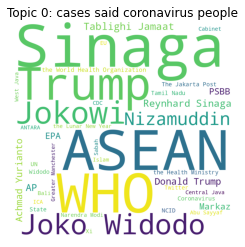

Topic:  1_market_company_indonesia_business


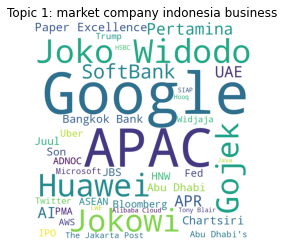

Topic:  2_sea_china_crew_fishing


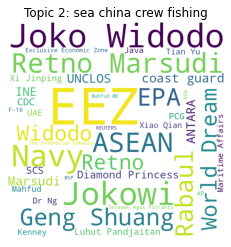

Topic:  3_flights_airlines_air_china


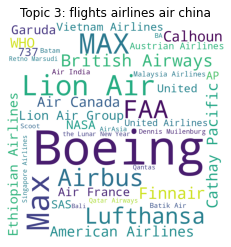

Topic:  4_australia_papua_dutch_indonesia


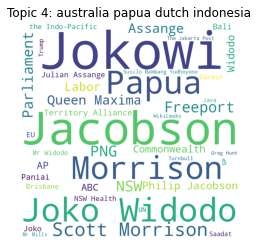

Topic:  5_getty_via_afp_medical


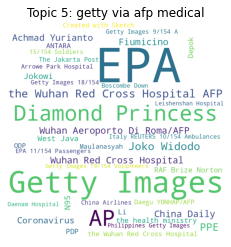

Topic:  6_oil_palm_imports_exports


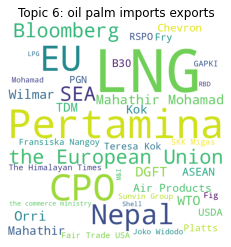

Topic:  7_council_syria_security_saudi


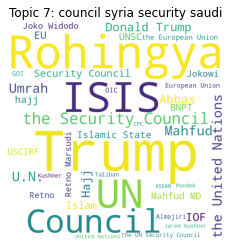

Topic:  8_sugar_food_rice_coffee


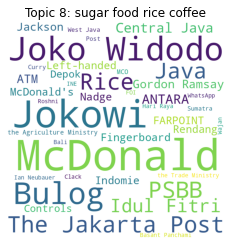

Topic:  9_tax_bank_economic_indonesia


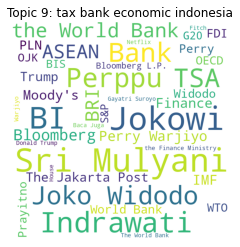

Topic:  10_jakarta_floods_disaster_flood


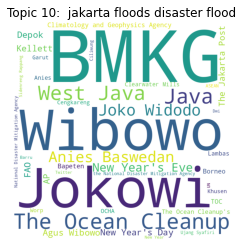

Topic:  11_species_conservation_animals_forest


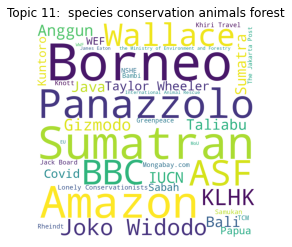

Topic:  12_data_information_users_tiktok


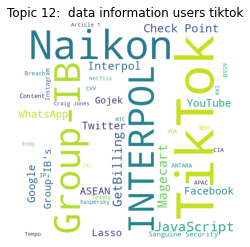

Topic:  13_trade_kpk_agreement_pdip


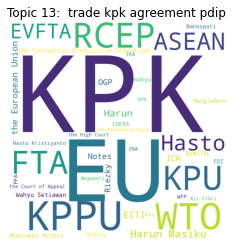

Topic:  14_airbus_steel_antidumping_bribery


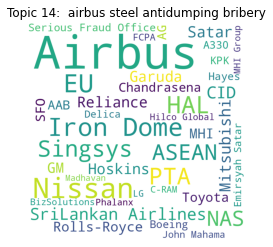

Topic:  15_ramadan_prayers_mosque_muslims


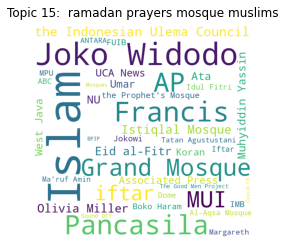

Topic:  16_bali_tourism_tourists_tourist


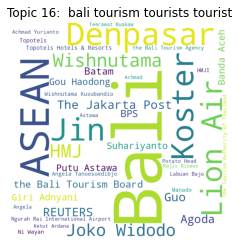

Topic:  17_workers_bill_migrant_employers


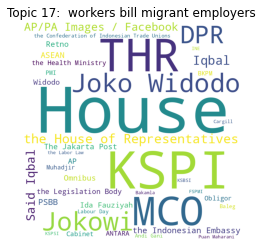

Topic:  18_indopacific_us_defense_china


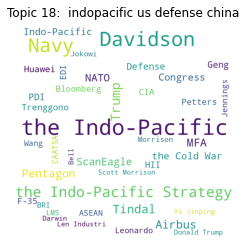

Topic:  19_women_child_sex_lgbt


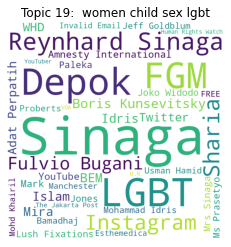

Topic:  20_plastic_water_swimming_sitti


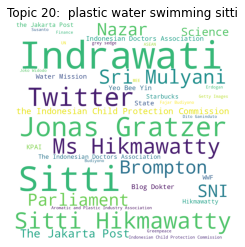

Topic:  21_power_energy_plant_coal


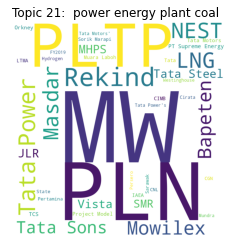

Topic:  22_drug_drugs_police_penalty


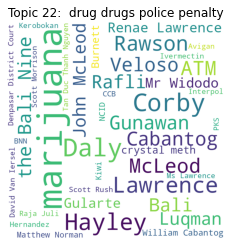

Topic:  23_test_testing_kits_tests


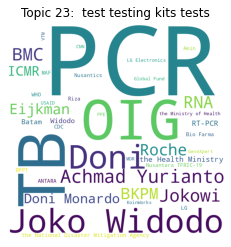

Topic:  24_eruption_volcano_ash_mount


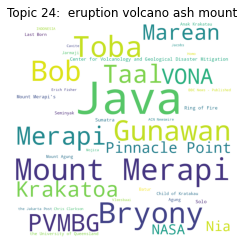

Topic:  25_jiwasraya_insurance_bpjs_insurer


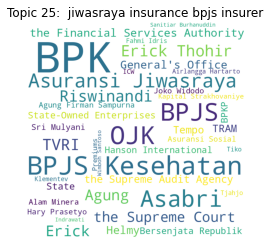

Topic:  26_court_mco_jail_wto


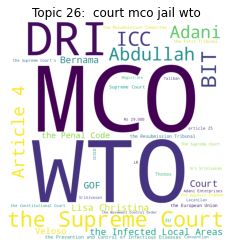

Topic:  27_nickel_coal_mining_ore


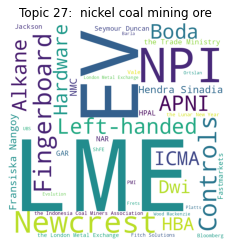

Topic:  28_relations_cooperation_bilateral_indonesia


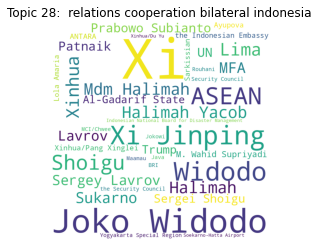

Topic:  29_information_media_hoaxes_journalists


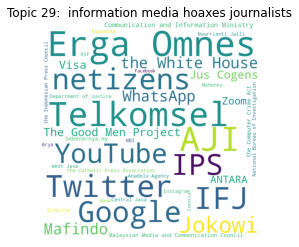

Topic:  30_village_ghosts_haunted_pocong


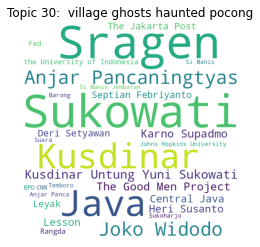

Topic:  31_art_museum_artists_kris


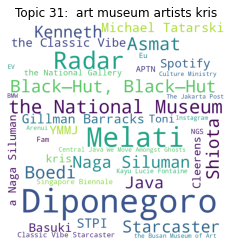

Topic:  32_crocodile_tire_reward_reptile


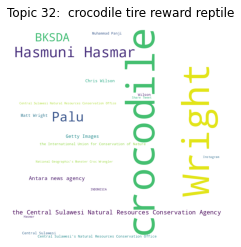

Topic:  33_prisoners_inmates_prison_release


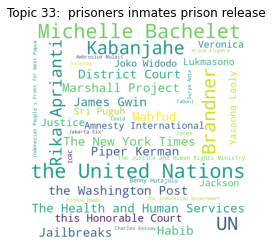

Topic:  34_monash_university_universities_students


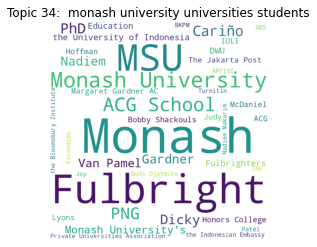

Topic:  35_brands_brand_products_beauty


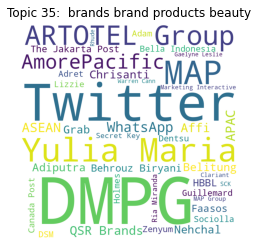

Topic:  36_kashmir_jammu_srinagar_positive


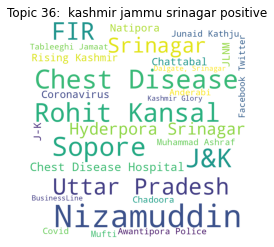

Topic:  37_poor_households_effendy_muhadjir


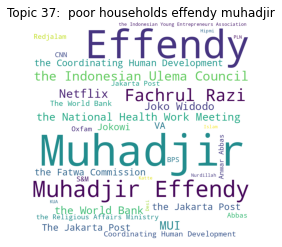

<Figure size 432x288 with 0 Axes>

In [ ]:
# Plot word cloud
for i in range(38):
  print("Topic: ", ner_grouped['topic_name'].loc[i])
  # Extract word_freq
  word_freq = ner_grouped['ner_filtered'].loc[i]

  # Create a WordCloud object
  wordcloud = WordCloud(width=800, 
                        height=800, 
                        background_color='white', 
                        min_font_size=10).generate_from_frequencies(word_freq)

  # Plot the WordCloud
  plt.imshow(wordcloud)
  plt.title("Topic " + str(i) + ": "+ner_grouped['topic_name'].loc[i][2:].replace('_', ' '))
  plt.axis("off")
  plt.show()
  plt.clf()

# Topic Keywords interaction

In [ ]:
keyword_grouped = df.groupby('topics')['keywords_textrank'].agg(sum).reset_index()
keyword_grouped['keywords_textrank'] = keyword_grouped['keywords_textrank'].apply(lambda x:count_items(x, 30, 10))
keyword_grouped.head(30)

,topics,keywords_textrank
0,0,"{'indonesia': 1626, 'covid-19': 1213, 'indones..."
1,1,"{'indonesia': 510, 'indonesian': 372, 'covid-1..."
2,2,"{'indonesia': 307, 'indonesian': 268, 'china':..."
3,3,"{'indonesia': 347, 'indonesian': 231, 'china':..."
4,4,"{'indonesia': 315, 'malaysia': 152, 'indonesia..."
5,5,"{'indonesia': 319, 'one': 179, 'indonesian': 1..."
6,6,"{'indonesia': 156, 'china': 96, 'airline': 77,..."
7,7,"{'indonesia': 165, 'indonesian': 104, 'jakarta..."
8,8,"{'indonesia': 125, 'indonesian': 94, 'one': 93..."
9,9,"{'indonesia': 181, 'indonesian': 116, 'jakarta..."


It seems like covid19 is a common theme throughout most topics

# Topic Sentiment interaction

In [ ]:
sentiments_grouped = df.groupby('topics')['compound'].agg('mean').reset_index()
sentiments_grouped.head(40)

,topics,compound
0,0,-0.036706
1,1,-0.161655
2,2,0.138244
3,3,0.132870
4,4,0.199779
5,5,0.774450
6,6,-0.138725
7,7,0.406523
8,8,0.501647
9,9,0.187161


# Topic Across News Outlet

In [ ]:
df['source'] = df['SOURCEURL'].str.split('/').str.get(2).replace(r'www[\d]?.', '', regex=True).apply(lambda x: '.'.join(x.split('.')[:-1]) if len(x.split('.'))>1 else x)
news_outlet_grouped = df.groupby('source')['topic_name'].agg(list).apply(set).apply(list).reset_index()
news_outlet_grouped.head(40)

,source,topic_name
0,1460kltc.iheart,[30_village_ghosts_haunted_pocong]
1,325.nostate,[4_australia_papua_dutch_indonesia]
2,35mmc,[0_cases_said_coronavirus_people]
3,365.military,[2_sea_china_crew_fishing]
4,680news,"[0_cases_said_coronavirus_people, 7_council_sy..."
5,7news.com,[4_australia_papua_dutch_indonesia]
6,929thebull,[5_getty_via_afp_medical]
7,9and10news,[0_cases_said_coronavirus_people]
8,9news.com,"[0_cases_said_coronavirus_people, 6_oil_palm_i..."
9,aa.com,[18_indopacific_us_defense_china]


In [ ]:
outlet_grouped_ = news_outlet_grouped.explode('topic_name')
# Get number of news outlet per topic in order
outlet_grouped_ = outlet_grouped_.groupby('topic_name')['source'].nunique().sort_values().reset_index()
outlet_grouped_['topics'] = outlet_grouped_['topic_name'].str[:2].str.replace('_', '')
outlet_grouped_.head()

,topic_name,source,topics
0,36_kashmir_jammu_srinagar_positive,12,36
1,37_poor_households_effendy_muhadjir,14,37
2,25_jiwasraya_insurance_bpjs_insurer,15,25
3,35_brands_brand_products_beauty,19,35
4,34_monash_university_universities_students,20,34


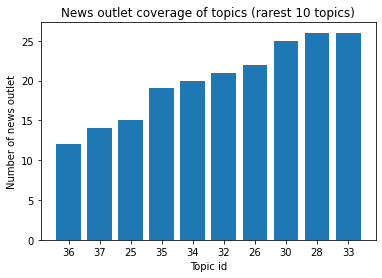

['36_kashmir_jammu_srinagar_positive'
 '37_poor_households_effendy_muhadjir'
 '25_jiwasraya_insurance_bpjs_insurer' '35_brands_brand_products_beauty'
 '34_monash_university_universities_students'
 '32_crocodile_tire_reward_reptile' '26_court_mco_jail_wto'
 '30_village_ghosts_haunted_pocong'
 '28_relations_cooperation_bilateral_indonesia'
 '33_prisoners_inmates_prison_release']


In [ ]:
# Plot bottom 10 charts
plt.bar(outlet_grouped_.iloc[:10].topics, outlet_grouped_.iloc[:10].source)
plt.xlabel('Topic id')
plt.ylabel('Number of news outlet')
plt.title('News outlet coverage of topics (rarest 10 topics)')
plt.show()
print(outlet_grouped_.iloc[:10].topic_name.values)

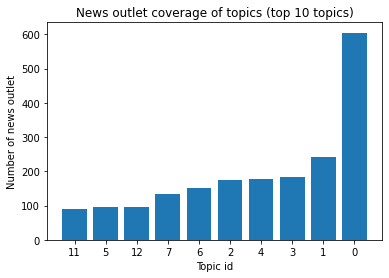

['11_species_conservation_animals_forest' '5_getty_via_afp_medical'
 '12_data_information_users_tiktok' '7_council_syria_security_saudi'
 '6_oil_palm_imports_exports' '2_sea_china_crew_fishing'
 '4_australia_papua_dutch_indonesia' '3_flights_airlines_air_china'
 '1_market_company_indonesia_business' '0_cases_said_coronavirus_people']


In [ ]:
# Plot bottom 10 charts
plt.bar(outlet_grouped_.iloc[-10:].topics, outlet_grouped_.iloc[-10:].source)
plt.xlabel('Topic id')
plt.ylabel('Number of news outlet')
plt.title('News outlet coverage of topics (top 10 topics)')
plt.show()
print(outlet_grouped_.iloc[-10:].topic_name.values)

# Example titles per topic

Show some titles per topic to glean some information

In [37]:
df = pd.read_csv('{}/topic_model_final.csv'.format(data_fp), index_col = 0)
df['ner'] = df['ner'].apply(lambda x: literal_eval(x))
df['topic_name'] = df['topic_name'].apply(lambda x: str(x)[:2].replace('_', ' '))
df[(df['topics']<=10)&(df['ner'].apply(lambda x: 'Indonesia' in x))][['topic_name', 'Title']].groupby('topic_name').head(2).sort_values('topic_name')

,topic_name,Title
1,0,"17 foreign, two Indian participants of Nizamud..."
2,0,Latest coronavirus update: Tamil Nadu sees big...
18,1,"Indonesian startups ProSpark, Webtrace raise f..."
80,1,The return of the Indonesian MotoGP
303,10,"As flood waters recede, Jakarta residents file..."
310,10,Plea to revert Puncak as water catchment area
26,2,Hundreds of Indonesian crew members flying in ...
56,2,Coronavirus: Obese cruise passenger unable to ...
24,3,Saffers stuck in Indonesia say Emirates and SA...
45,3,How can Britons abroad get on rescue flights b...
